The model and data at healthdata.org includes start and stop dates for various categories of lockdown measures (e.g. closing schools, any transit restrictions, closures of non-essential businesses) as well as estimates of current cases for many countries (and some sub-country regions). If we approximate the dymanics as exponential processes (like the SIR family of models but without saturation) we can estimate the current rate of spread and correlate that with current lockdown measures.

Some future possibilities:
- we could use the google mobility data or healthdata's aggregate of that mobility data to identify countermeasures that are effective beyond what we would predict from the change in mobility alone

In [1]:
from itertools import permutations, product

import holoviews as hv
import numpy as np
import pandas as pd
import pymc3 as pm

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
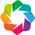

In [2]:
hv.notebook_extension('bokeh')
%opts Overlay [aspect=5/3, responsive=True]

In [27]:
healthdata = pd.read_csv('2020_05_28/Hospitalization_all_locs.csv', parse_dates=['date'])

stats = pd.read_csv('2020_05_28/Summary_stats_all_locs.csv', parse_dates=[
    'peak_bed_day_mean', 'peak_bed_day_lower',
    'peak_bed_day_upper', 'peak_icu_bed_day_mean', 'peak_icu_bed_day_lower',
    'peak_icu_bed_day_upper', 'peak_vent_day_mean', 'peak_vent_day_lower',
    'peak_vent_day_upper', 'travel_limit_start_date', 'travel_limit_end_date',
    'stay_home_start_date', 'stay_home_end_date',
    'educational_fac_start_date', 'educational_fac_end_date',
    'any_gathering_restrict_start_date', 'any_gathering_restrict_end_date',
    'any_business_start_date', 'any_business_end_date',
    'all_non-ess_business_start_date', 'all_non-ess_business_end_date',
])

In [4]:
# We will melt the start and end dates and drop the missing data so we can determine
# whether or not a policy was in place using an asof merge to the most recent change
countermeasures = stats.melt(
    id_vars=['location_name'],
    value_vars=[c for c in stats.columns if 'date' in c],
    value_name='date'
).dropna()
countermeasures['type'] = countermeasures['variable'].apply(
    lambda name: '_'.join(name.replace('-', '_').split('_')[:-2])
)
countermeasure_types = sorted(set(countermeasures['type']))
countermeasures['enforced'] = countermeasures['variable'].apply(lambda name: name.split('_')[-2] == 'start')
countermeasures.drop(columns=['variable'], inplace=True)
countermeasures.sort_values('date', inplace=True)
countermeasure_types

['all_non_ess_business',
 'any_business',
 'any_gathering_restrict',
 'educational_fac',
 'stay_home',
 'travel_limit']

In [5]:
merged = healthdata.copy()

# healthdata uses projections for the past two weeks just as they do for future dates
# as a mitigation for lag in reporting. To look only at estimates for days with data,
# discard anything newer than two weeks before the latest data.
merged.dropna(subset=['confirmed_infections'], inplace=True)
merged = merged.loc[merged['date'] < merged['date'].max() - pd.to_timedelta('2w')]

# Regions that are decomposed are stored here, too, but without countermeasure data.
# Therefore we discard the groups and keep their subdivisions
group_names = [
    'Brazil',
    'Canada',
    'Germany',
    'Italy',
    'Mexico',
    'Spain',
    'United States of America',
]
merged = merged.loc[~merged['location_name'].apply(group_names.__contains__)]

# to reduce noise, only investigate growth once a location has at least N infections
N = 200
merged = merged.loc[merged['est_infections_mean'] > N]

# Drop locations with fewer than N samples
enough = merged.groupby('location_name')['V1'].count() >= 40
merged = merged.merge(enough, left_on='location_name', right_index=True)
merged = merged.loc[merged['V1_y']]

merged.sort_values('date', inplace=True)

for countermeasure_type, subset in countermeasures.groupby('type'):
    subset = subset.drop(columns='type').rename(columns={'enforced': countermeasure_type})
    merged = pd.merge_asof(merged, subset, on='date', by='location_name')
    merged[countermeasure_type].fillna(False, inplace=True)

cols = ['est_infections_mean', 'est_infections_lower', 'est_infections_upper']
diffs = merged.groupby('location_name')[cols].diff().rename(columns={c: f'diff_{c}' for c in cols})
merged = pd.concat([merged, diffs], axis=1)

merged['fractional_diff_est_infections_mean'] = merged['diff_est_infections_mean'] / merged['est_infections_mean']

merged['day_of_year'] = merged['date'].dt.dayofyear
merged['day_of_week'] = merged['date'].dt.dayofweek
merged['random'] = np.random.normal(size=len(merged))

print(len(healthdata), len(merged))

49115 9139


In [6]:
merged['num_active'] = 0
for countermeasure_type in countermeasure_types:
    merged['num_active'] += merged[countermeasure_type]

(
    hv.Scatter(merged, 'date', ['fractional_diff_est_infections_mean', 'num_active'])
    .options(alpha=0.3, jitter=5e7, legend_position='right', aspect=5/3, responsive=True,
             colorbar=True, cmap='viridis', color=hv.dim('num_active'))
)

:Scatter   [date]   (fractional_diff_est_infections_mean,num_active)

In [7]:
hv.HoloMap({
    countermeasure_type:
    hv.Scatter(
        merged.loc[~merged[countermeasure_type]],
        'date', ['fractional_diff_est_infections_mean', 'location_name'] + countermeasure_types,
        label='False'
    ).options(alpha=0.3, jitter=5e7, aspect=5/3, responsive=True, tools=['hover']) *
    hv.Scatter(
        merged.loc[merged[countermeasure_type]],
        'date', ['fractional_diff_est_infections_mean', 'location_name'] + countermeasure_types,
        label='True'
    ).options(alpha=0.3, jitter=5e7, tools=['hover'])
    for countermeasure_type in countermeasure_types
}, 'Countermeasure').layout().cols(1)

:NdLayout   [Countermeasure]
   :Overlay
      .Scatter.False :Scatter   [date]   (fractional_diff_est_infections_mean,location_name,all_non_ess_business,any_business,any_gathering_restrict,educational_fac,stay_home,travel_limit)
      .Scatter.True  :Scatter   [date]   (fractional_diff_est_infections_mean,location_name,all_non_ess_business,any_business,any_gathering_restrict,educational_fac,stay_home,travel_limit)

In [8]:
X = merged.copy()
X['random'] = np.random.uniform(-1, 1, size=len(X))
X.sort_values('random', inplace=True)

plots = {}
for a, b in product(countermeasure_types, countermeasure_types):
    x = X.copy()
    x[b] += 0.4 * np.tanh(5.0 * x['fractional_diff_est_infections_mean'])
    if a != b:
        x[a] += 0.36 * x['random']
    plots[(a, b)] = (
        hv.Scatter(x, [a, b], 'fractional_diff_est_infections_mean')
        .options(color=hv.dim('fractional_diff_est_infections_mean'), alpha=0.05, cmap='viridis')
    )

(
    hv.GridSpace(plots, sort=True)
    .options(xrotation=45, yrotation=45)
    .redim.range(fractional_diff_est_infections_mean=(-0.1, 0.3))
)

:GridSpace   [X,Y]
   :Scatter   [travel_limit,travel_limit]   (fractional_diff_est_infections_mean)

In [9]:
def plot_trace(trace, varnames=None):
    """Plot the distribution and trace for each latent variable in a pymc trace object.
    
    trace: the trace output from pymc.sample
    varnames: Optional specification of variables to include in the trace plot. If None, use all variables not ending with '_'
    """
    plots = []
    for var in varnames or [var for var in trace.varnames if not var.endswith('_')]:
        x = trace.get_values(var, combine=False)
        if not isinstance(x, list):
            x = [x]
        plots.append(hv.Overlay([hv.Distribution(xi, [var], [f'p({var})']) for xi in x], group=var).options(aspect=3))
        plots.append(hv.Overlay([hv.Curve(xi, 'index', var).options(alpha=0.6) for xi in x]).options(aspect=3))
    return hv.Layout(plots).cols(2)

In [10]:
# A stay at home order is a gathering restriction
# A shutdown of non-essential businesses is a business restriction
# For more interpretable results, separate their effects

x = merged[[
    'fractional_diff_est_infections_mean',
    'date',
    'day_of_week',
    'location_name'
] + countermeasure_types].dropna()
location_indices, location_names = pd.factorize(x['location_name'])

pairs = set(tuple(sorted([a, b])) for a, b in permutations(countermeasure_types, 2))

with pm.Model() as model:
    
    rate = pm.Normal('baseline_rate', mu=0.4, sigma=0.2, shape=len(location_names))[location_indices]
    
    # Model the weekly periodicity
    amplitude = pm.HalfNormal('amplitude', sigma=0.4, shape=len(location_names))[location_indices]
    phase0 = pm.Uniform('phase0', 0, 7, shape=len(location_names))[location_indices]
    rate += amplitude * np.cos(2 * np.pi * (np.asarray(x['day_of_week']) - phase0) / 7)
    
    rate += pm.Normal('educational_fac', mu=0, sigma=0.4) * np.asarray(x['educational_fac'])
    rate += pm.Normal('travel_limit', mu=0, sigma=0.4) * np.asarray(x['travel_limit'])
    rate += pm.Normal('all_non_ess_business', mu=0, sigma=0.4) * np.asarray(x['all_non_ess_business'])
    rate += pm.Normal('stay_home', mu=0, sigma=0.4) * np.asarray(x['stay_home'])
    rate += pm.Normal('any_gathering_restrict', mu=0, sigma=0.4) * np.asarray(x['any_gathering_restrict'] & ~x['stay_home'])
    rate += pm.Normal('any_business', mu=0, sigma=0.4) * np.asarray(x['any_business'] & ~x['all_non_ess_business'])
    
    # Model effect of both stay_home and all_non_ess_business
    # Should be positive since we expect both to be not quite as good as the sum of each measure separately
    rate += pm.Normal('stay_home&all_non_ess_business', mu=0, sigma=0.4) * np.asarray(x['stay_home'] & x['all_non_ess_business'])
    
    pm.Deterministic('rate', rate)
    
    err = pm.HalfNormal('err', sigma=0.4, shape=len(location_names))[location_indices]
    pm.Normal('observations', mu=rate, sigma=err,
              observed=np.asarray(x['fractional_diff_est_infections_mean']))
    
    trace = pm.sample(3_000, tune=1_000, chains=4, cores=4)
    
plot_trace(trace, varnames=countermeasure_types + ['stay_home&all_non_ess_business'])

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [err, stay_home&all_non_ess_business, any_business, any_gathering_restrict, stay_home, all_non_ess_business, travel_limit, educational_fac, phase0, amplitude, baseline_rate]
Sampling 4 chains, 0 divergences: 100%|██████████| 16000/16000 [05:45<00:00, 46.25draws/s]
The number of effective samples is smaller than 10% for some parameters.


:Layout
   .All_non_ess_business.I                     :Overlay
      .Distribution.I   :Distribution   [all_non_ess_business]   (p(all_non_ess_business))
      .Distribution.II  :Distribution   [all_non_ess_business]   (p(all_non_ess_business))
      .Distribution.III :Distribution   [all_non_ess_business]   (p(all_non_ess_business))
      .Distribution.IV  :Distribution   [all_non_ess_business]   (p(all_non_ess_business))
   .Overlay.I                                  :Overlay
      .Curve.I   :Curve   [index]   (all_non_ess_business)
      .Curve.II  :Curve   [index]   (all_non_ess_business)
      .Curve.III :Curve   [index]   (all_non_ess_business)
      .Curve.IV  :Curve   [index]   (all_non_ess_business)
   .Any_business.I                             :Overlay
      .Distribution.I   :Distribution   [any_business]   (p(any_business))
      .Distribution.II  :Distribution   [any_business]   (p(any_business))
      .Distribution.III :Distribution   [any_business]   (p(any_business))
      .Distribution.IV  :Distribution   [any_business]   (p(any_business))
   .Overlay.II                                 :Overlay
      .Curve.I   :Curve   [index]   (any_business)
      .Curve.II  :Curve   [index]   (any_business)
      .Curve.III :Curve   [index]   (any_business)
      .Curve.IV  :Curve   [index]   (any_business)
   .Any_gathering_restrict.I                   :Overlay
      .Distribution.I   :Distribution   [any_gathering_restrict]   (p(any_gathering_restrict))
      .Distribution.II  :Distribution   [any_gathering_restrict]   (p(any_gathering_restrict))
      .Distribution.III :Distribution   [any_gathering_restrict]   (p(any_gathering_restrict))
      .Distribution.IV  :Distribution   [any_gathering_restrict]   (p(any_gathering_restrict))
   .Overlay.III                                :Overlay
      .Curve.I   :Curve   [index]   (any_gathering_restrict)
      .Curve.II  :Curve   [index]   (any_gathering_restrict)
      .Curve.III :Curve   [index]   (any_gathering_restrict)
      .Curve.IV  :Curve   [index]   (any_gathering_restrict)
   .Educational_fac.I                          :Overlay
      .Distribution.I   :Distribution   [educational_fac]   (p(educational_fac))
      .Distribution.II  :Distribution   [educational_fac]   (p(educational_fac))
      .Distribution.III :Distribution   [educational_fac]   (p(educational_fac))
      .Distribution.IV  :Distribution   [educational_fac]   (p(educational_fac))
   .Overlay.IV                                 :Overlay
      .Curve.I   :Curve   [index]   (educational_fac)
      .Curve.II  :Curve   [index]   (educational_fac)
      .Curve.III :Curve   [index]   (educational_fac)
      .Curve.IV  :Curve   [index]   (educational_fac)
   .Stay_home.I                                :Overlay
      .Distribution.I   :Distribution   [stay_home]   (p(stay_home))
      .Distribution.II  :Distribution   [stay_home]   (p(stay_home))
      .Distribution.III :Distribution   [stay_home]   (p(stay_home))
      .Distribution.IV  :Distribution   [stay_home]   (p(stay_home))
   .Overlay.V                                  :Overlay
      .Curve.I   :Curve   [index]   (stay_home)
      .Curve.II  :Curve   [index]   (stay_home)
      .Curve.III :Curve   [index]   (stay_home)
      .Curve.IV  :Curve   [index]   (stay_home)
   .Travel_limit.I                             :Overlay
      .Distribution.I   :Distribution   [travel_limit]   (p(travel_limit))
      .Distribution.II  :Distribution   [travel_limit]   (p(travel_limit))
      .Distribution.III :Distribution   [travel_limit]   (p(travel_limit))
      .Distribution.IV  :Distribution   [travel_limit]   (p(travel_limit))
   .Overlay.VI                                 :Overlay
      .Curve.I   :Curve   [index]   (travel_limit)
      .Curve.II  :Curve   [index]   (travel_limit)
      .Curve.III :Curve   [index]   (travel_limit)
      .Curve.IV  :Curve   [index]   (travel_limit)
   .Stay_home_ampersand_all_non_ess_business.I :Overlay
      .Distribution.I   

In [11]:
hv.Overlay([
    hv.Distribution(trace[countermeasure_type], label=countermeasure_type)
    for countermeasure_type in countermeasure_types + ['stay_home&all_non_ess_business']
]).options(aspect=5/3, responsive=True)

:Overlay
   .Distribution.All_non_ess_business                     :Distribution   [Value]   (Density)
   .Distribution.Any_business                             :Distribution   [Value]   (Density)
   .Distribution.Any_gathering_restrict                   :Distribution   [Value]   (Density)
   .Distribution.Educational_fac                          :Distribution   [Value]   (Density)
   .Distribution.Stay_home                                :Distribution   [Value]   (Density)
   .Distribution.Travel_limit                             :Distribution   [Value]   (Density)
   .Distribution.Stay_home_ampersand_all_non_ess_business :Distribution   [Value]   (Density)

In [12]:
samples = pd.DataFrame(list(zip(
    trace['baseline_rate'].ravel(),
    trace['amplitude'].ravel(),
    trace['phase0'].ravel(),
    trace['err'].ravel(),
    np.array(location_names)[None, :].repeat(4000, axis=0).ravel()
)), columns=['baseline_rate', 'amplitude', 'phase0', 'err', 'location'])

samples = samples.merge(samples.groupby('location')['baseline_rate'].mean(), on='location', suffixes=('', '_mean'))
samples.sort_values('baseline_rate_mean', inplace=True)

hv.HoloMap({
    variable: hv.Violin(samples, 'location', variable)
    .options(aspect=5/3, responsive=True, xrotation=90)
    for variable in ['baseline_rate', 'amplitude', 'phase0', 'err']
}).layout().cols(1)

:NdLayout   [Default]
   :Violin   [location]   (phase0)

In [13]:
percentile = np.linspace(0, 100, 1003)[1:-1]
tail_percentile = 100 - abs(percentile * 2 - 100)
    
def plot_rate(location):
    idx = location_names.get_loc(location)
    these = location_indices == idx
    rate = trace['rate'][:, these]
    Y = np.percentile(rate, percentile, axis=0)
    
    t = x.loc[these, 'date']
    df = [{'t': t, 'rate': y, 'P': p} for y, p in zip(Y, tail_percentile)]
    return (
        hv.Contours(df, ['t', 'rate'], 'P')
        .options(cmap='plasma', colorbar=True, show_legend=False, line_width=2, logz=True, cformatter='%.2g%%') *
        hv.Curve(merged.loc[merged['location_name'] == location], 'date', 'fractional_diff_est_infections_mean')
    ).options(aspect=5/3, responsive=True)

In [14]:
plot_rate('Lombardia')

:Overlay
   .Contours.I :Contours   [t,rate]   (P)
   .Curve.I    :Curve   [date]   (fractional_diff_est_infections_mean)

In [15]:
plot_rate('Veneto')

:Overlay
   .Contours.I :Contours   [t,rate]   (P)
   .Curve.I    :Curve   [date]   (fractional_diff_est_infections_mean)

In [16]:
plot_rate('Virginia')

:Overlay
   .Contours.I :Contours   [t,rate]   (P)
   .Curve.I    :Curve   [date]   (fractional_diff_est_infections_mean)

In [26]:
plot_rate('New York')

:Overlay
   .Contours.I :Contours   [t,rate]   (P)
   .Curve.I    :Curve   [date]   (fractional_diff_est_infections_mean)

In [24]:
plot_rate('France')

:Overlay
   .Contours.I :Contours   [t,rate]   (P)
   .Curve.I    :Curve   [date]   (fractional_diff_est_infections_mean)

In [17]:
# hv.DynamicMap(plot_rate, kdims=['Location']).redim.values(Location=sorted(location_names))

In [28]:
location_names

Index(['Republic of Korea', 'Washington', 'Basque Country', 'United Kingdom',
       'Japan', 'Philippines', 'Veneto', 'Castilla-La Mancha', 'Piemonte',
       'Marche',
       ...
       'Utah', 'Paraiba', 'Rio Grande do Sul', 'Goias', 'New Hampshire',
       'Nebraska', 'Amapa', 'Thuringia', 'Acre', 'Alagoas'],
      dtype='object', length=143)